# Infinite Jukebox Clone

## About
We wanted to think of a way to prolong a song for longer than it's actual runtime. While thinking of different ways to approach this, we remembered a project that was showed in class -- the [infinite jukebox](infinitejukebox.playlistmachinery.com). After looking further into it, we thought it would be a cool idea to attempt creating our own version of an infinite jukebox. This project isn't groundbreaking or outstandingly creative by any means, but we learned a lot by implementing concepts that we learned in class in an interesting way.

At a high level, an infinite jukebox can be broken down into the idea that we break down the song into a series of feature vectors and then we can aggregate those feature vectors into each beat of the song. Once that is done, we find the beats that are very similar and can now loop back and forth without the listener (hopefully) noticing.

There were a lot of different factors to play around with. Things like which features we wanted to use, our distance measure for our similarity matrix, what our threshold should be to deem two beats similar enough, and how we chose to aggregate our features into beats. There was also the task of creating a user-friendly UI to demonstrate which beats are correlated with which other beats. (Specfic factors will be discussed further down).

This Jupyter Notebook explores our process and how we built our own infinite jukebox with the song Call Me Maybe. We chose this song because it was used in the original infinite jukebox and could serve as an easy comparison.

In [1]:
import sys
print("Python version:       %6.6s (need at least 3.0.0)" % sys.version)

import IPython, numpy as np, scipy as sp, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath, math, random
import librosa.display
%matplotlib inline
# NOTE: librosa may take a while to import

print("IPython version:      %6.6s (need at least 4.0.1)" % IPython.__version__)
print("Numpy version:        %6.6s (need at least 1.10.1)" % np.__version__)
print("SciPy version:        %6.6s (need at least 0.16.0)" % sp.__version__)
print("Matplotlib version:   %6.6s (need at least 1.5.0)" % matplotlib.__version__)
print("Scikit-Learn version: %6.6s (need at least 0.17)" % sklearn.__version__)
print("Librosa version:      %6.6s (need at least 0.4.1)" % librosa.__version__)

from IPython.display import Audio

Python version:       3.6.7  (need at least 3.0.0)
IPython version:       7.2.0 (need at least 4.0.1)
Numpy version:        1.15.4 (need at least 1.10.1)
SciPy version:         1.2.0 (need at least 0.16.0)
Matplotlib version:    3.0.2 (need at least 1.5.0)
Scikit-Learn version: 0.20.2 (need at least 0.17)
Librosa version:       0.6.2 (need at least 0.4.1)


# Splitting the song into its beats
The first step was to determine where each beat was in the audio sample. Thankfully, Librosa provides a function to do just that for us. One thing we noticed was that there seemed to be some dead time in the beginning of the audio that doesn't correspond to the beginning of the first beat, so we clipped the beginning of the audio to account for that. 

In [2]:
file_path = './audio/Call_me_maybe.wav'
audio, sr = librosa.load(file_path)
hop_length = 1024
n_fft = 2048

# not sure about params - just took from hw0
bpm, beat_frames = librosa.beat.beat_track(y=audio,
                                       sr=sr,
                                       hop_length=hop_length,
                                       start_bpm=120,
                                       tightness=200)

beats = librosa.frames_to_samples(beat_frames, hop_length=hop_length)

# finding the starting point of the audio file (assuming the beginning gets cut off)
starting_point = beats[0] - (beats[1] - beats[0])
#audio = audio[starting_point:]

# NOTE: if you want to see the similarity matrices generated set this to true
# However, generating and displaying them take a long time. 
show_graph = False

In [3]:
Audio(audio, rate=sr)

## Calculating Features
We decided to compare the results of using features generated from the MFCC and chroma spectrogram of the audio. 

### Helper Functions

In [4]:
def plot_similarity(s_matrix, title):
    plt.figure(figsize=(10, 10))
    librosa.display.specshow(s_matrix, x_axis='time', y_axis='time')
    plt.title(title)
    plt.colorbar()
    plt.tight_layout()

def clean_similarity_matrix(s_matrix, percent = .05, min_distance=10000):
    """
    Replaces 0s and non-bottom x-percent values with None to allow for easier plotting
    """
    shape = s_matrix.shape
    result = np.zeros(shape)
    cutoff_val = get_cutoff(s_matrix, percent)
    pairs = []
    for i in range(shape[0]):
        for j in range(shape[1]):
            if s_matrix[i, j] == 0 or s_matrix[i, j] > cutoff_val:
                result[i, j] = None
            else:
                result[i, j] = s_matrix[i, j]
                pairs.append((i, j, s_matrix[i, j]))
    return result, pairs

def get_cutoff(matrix, percent):
    nonzero = matrix[np.nonzero(matrix)]
    sorted_vals = np.sort(nonzero)
    size = len(sorted_vals)
    return sorted_vals[max(int(percent*size) - 1, 0)]

### Using MFCC as a Feature

In [5]:
mfcc = librosa.feature.mfcc(y=audio, sr=sr)
mfcc_sm = librosa.segment.recurrence_matrix(mfcc, mode='distance', metric='euclidean')

In [79]:
Audio(audio, rate=sr)

In this graph we show the similarity matrix of the 1 nearest neighbor for every feature vector. As you can see, there's a lot of jumbled mess, but 9 very distinct blocks stand out to me. It is at these times that the chorus is played, so it would make sense for every chorus section to be loosely related to each other. While it seems like there are extraodinarily dark patches in teh bottom left hand corner, as we narrow the points we choose to plot to only our most correlated pairs, we noticed that these patches don't persist. 

In [7]:
if show_graph:
    all_clean_mfcc_sm, all_pairs = clean_similarity_matrix(mfcc_sm, 1)
    plot_similarity(all_clean_mfcc_sm, f'MFCC Similarity: All')

This graph gives us a lot better information about the specific time correlations. By reducing the points plotted to only the best 1% in terms of our Euclidean distance measurement, we see a lot less of a block and more of a straight line which better represents specific parts in a chorus that corresponds to those same parts in the chorus at a different time. 

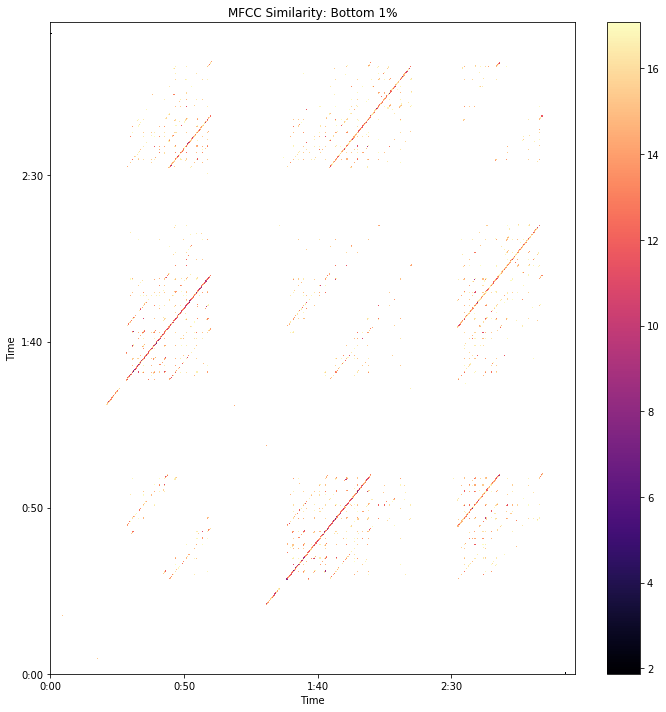

In [42]:
def clean(s_matrix, percent = .05, min_distance=10000):
    """
    Replaces 0s and non-bottom x-percent values with None to allow for easier plotting
    """
    shape = s_matrix.shape
    result = np.zeros(shape)
    cutoff_val = get_cutoff(s_matrix, percent)
    pairs = []
    for i in range(shape[0]):
        for j in range(shape[1]):
            if s_matrix[i, j] == 0 or s_matrix[i, j] > cutoff_val or abs(i - j) < 500:
                result[i, j] = None
            else:
                result[i, j] = s_matrix[i, j]
                pairs.append((i, j, s_matrix[i, j]))
    return result, pairs


if True:
    one_clean_mfcc_sm, one_pairs = clean(mfcc_sm, .01)
    plot_similarity(one_clean_mfcc_sm, f'MFCC Similarity: Bottom 1%')

In [43]:
print(len(one_pairs))
better_one_pairs = [(i, j, dist) for i, j, dist in one_pairs if abs(i - j) > 500]
print(len(better_one_pairs))


8976
8976


This graph seems to be a bit too ambitious by chasing after the best 0.1% performing pairs. Most of the information we got about pairs from the previous graph is now gone and we're only left with one small line of correlations. 

In [22]:
if True:
    p_one_clean_mfcc_sm, p_one_pairs = clean_similarity_matrix(mfcc_sm, .001)
    plot_similarity(p_one_clean_mfcc_sm, f'MFCC Similarity: Bottom 0.1%')

KeyboardInterrupt: 

In [10]:
# no_samples = mfcc.shape[1]
# samples = librosa.samples_like(no_samples/2, hop_length=hop_length, n_fft=n_fft)
# beat_pairs = {}
# for i, j, dist in one_pairs:
#     sample_i = samples[int(i/2)]
#     sample_j = samples[int(j/2)]
#     if sample_i == sample_j:
#         continue
        
#     beat_i_found = False
#     beat_i = 0
#     for b_i, sample_beat in enumerate(beats):
#         if beat_i_found and sample_beat > sample_i:
#             beat_i = b_i
#         if sample_beat > sample_j:
#             beat_j = b_i
#             if abs(beat_i - beat_j) > 0:
#                 beat_pairs[beat_i] = beat_j
#             break

# print(beat_pairs)
# print(beats[0])

### Using Chroma Spectrogram as a Feature

In [11]:
# chroma = librosa.feature.chroma_stft(y=audio, sr=sr, n_fft=n_fft, hop_length=hop_length)
# chroma_sm = librosa.segment.recurrence_matrix(chroma, mode='distance', metric='euclidean')
# print(f'similarity matrix shape for chroma spec: {chroma_sm.shape}')

In [12]:
# clean_chroma_sm = clean_similarity_matrix(chroma_sm)
# plot_similarity(clean_chroma_sm, 'Chroma Spec Similarity')

### Aggregating Features into Beats
In this section we attempt to aggregate our feature vectors into beats. The way we have it now, there are many more feature vectors, each representing the MFCC of a small part of the sample. Somehow these all have to be aggregated together so a beat can have it's own feature vector.

There's a bunch of different aggregation methods that we could use and have tried, and we haven't seen much noticeable difference between them. 

Honestly, the results here aren't the greatest. You can easily see the same grouping pattern at the chorus sections, but 

In [231]:
def agg_features(feature_matrix, beats, hop_length, aggregation='median'):
    '''
    This assumes that hop length is half of n_fft
    aggregation = 'median', 'average'
    '''
    agg_funcs = {
        'average': np.average,
        'median': np.median
    }
    feature_matrix = np.transpose(feature_matrix)
    print(feature_matrix[0].shape)
    beat_index = 0
    samples = []
    beat_features = []
    for i, f in enumerate(feature_matrix):
        starting_sample_number = hop_length/2 * i
        if beat_index >= len(beats) - 1:
            # things wont line up exactly because of rounding error
            break
        if starting_sample_number > beats[beat_index] and starting_sample_number + hop_length * 2 < beats[beat_index+1]:
            beat_index += 1
            # aggregate samples we've collected in this beat     
            np_samples = np.array(samples)
            aggregated = agg_funcs[aggregation](np_samples)
            beat_features.append(aggregated)
            s_length = len(samples)
            samples = []
        samples.append(f)
    return np.array(beat_features)


def agg(feature_matrix, beats, hop_length, aggregation='median'):
    agg_funcs = {
        'average': np.average,
        'median': np.median
    }
    feature_matrix = np.transpose(feature_matrix)
    print(len(feature_matrix))
    beat_index = 0
    samples = None
    beat_features = None
    
    for i, f in enumerate(feature_matrix):
        if i == 0:
            continue
            
        starting_sample_number = hop_length/2 * i
        if beat_index >= len(beats) - 1:
            # things wont line up exactly because of rounding error
            break
        if starting_sample_number > beats[beat_index]:
            # aggregate what we have now
            agg_value = np.mean(samples, axis=0)
            
            if beat_features is None:
                beat_features = np.array([agg_value])
            else:
                beat_features = np.concatenate((beat_features, np.array([agg_value])))
            print(beat_features.shape)

            beat_index += 1
            samples = None
            
        if samples is None:
            samples = np.array([f])
        else:
            samples = np.concatenate((samples, np.array([f])))
    return np.transpose(beat_features)


In [232]:
agg_mfcc = agg(mfcc, beats, hop_length)
print(len(beats))
#agg_chroma = agg_features(chroma, beats, hop_length)


8444
(1, 20)
(2, 20)
(3, 20)
(4, 20)
(5, 20)
(6, 20)
(7, 20)
(8, 20)
(9, 20)
(10, 20)
(11, 20)
(12, 20)
(13, 20)
(14, 20)
(15, 20)
(16, 20)
(17, 20)
(18, 20)
(19, 20)
(20, 20)
(21, 20)
(22, 20)
(23, 20)
(24, 20)
(25, 20)
(26, 20)
(27, 20)
(28, 20)
(29, 20)
(30, 20)
(31, 20)
(32, 20)
(33, 20)
(34, 20)
(35, 20)
(36, 20)
(37, 20)
(38, 20)
(39, 20)
(40, 20)
(41, 20)
(42, 20)
(43, 20)
(44, 20)
(45, 20)
(46, 20)
(47, 20)
(48, 20)
(49, 20)
(50, 20)
(51, 20)
(52, 20)
(53, 20)
(54, 20)
(55, 20)
(56, 20)
(57, 20)
(58, 20)
(59, 20)
(60, 20)
(61, 20)
(62, 20)
(63, 20)
(64, 20)
(65, 20)
(66, 20)
(67, 20)
(68, 20)
(69, 20)
(70, 20)
(71, 20)
(72, 20)
(73, 20)
(74, 20)
(75, 20)
(76, 20)
(77, 20)
(78, 20)
(79, 20)
(80, 20)
(81, 20)
(82, 20)
(83, 20)
(84, 20)
(85, 20)
(86, 20)
(87, 20)
(88, 20)
(89, 20)
(90, 20)
(91, 20)
(92, 20)
(93, 20)
(94, 20)
(95, 20)
(96, 20)
(97, 20)
(98, 20)
(99, 20)
(100, 20)
(101, 20)
(102, 20)
(103, 20)
(104, 20)
(105, 20)
(106, 20)
(107, 20)
(108, 20)
(109, 20)
(110, 20)
(11

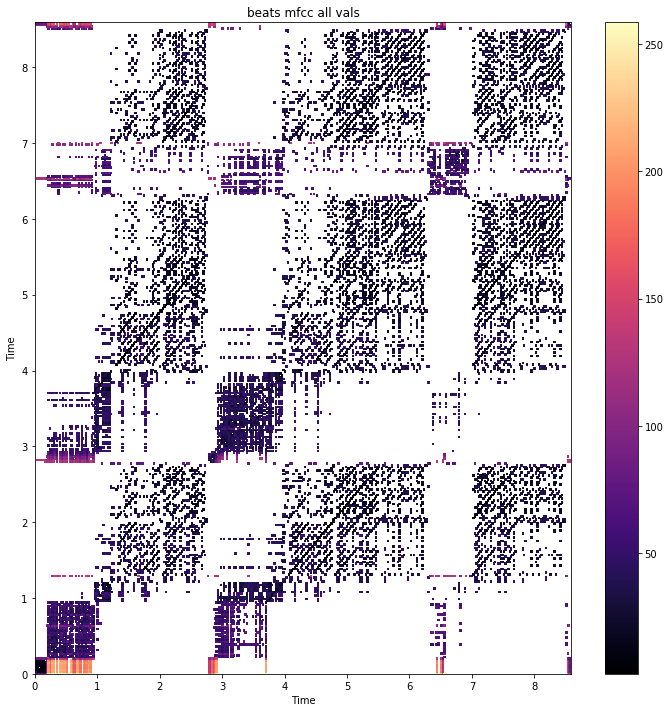

In [233]:
agg_mfcc_sm = librosa.segment.recurrence_matrix(agg_mfcc, mode='distance', metric='euclidean')
clean_agg_mfcc_sm, pairs = clean_similarity_matrix(agg_mfcc_sm, 1)
plot_similarity(clean_agg_mfcc_sm, 'beats mfcc all vals')

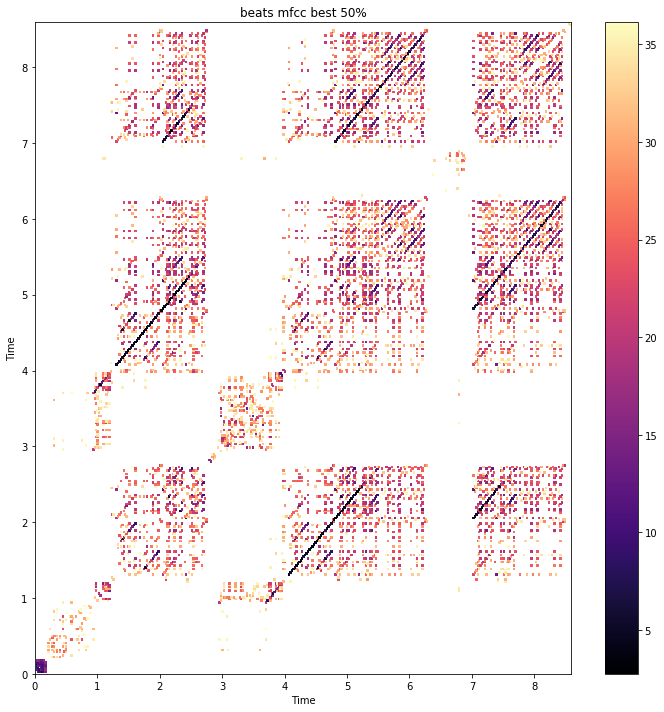

In [234]:
agg_mfcc_sm = librosa.segment.recurrence_matrix(agg_mfcc, mode='distance', metric='euclidean')
clean_agg_mfcc_sm, pairs = clean_similarity_matrix(agg_mfcc_sm, .5)
plot_similarity(clean_agg_mfcc_sm, 'beats mfcc best 50%')

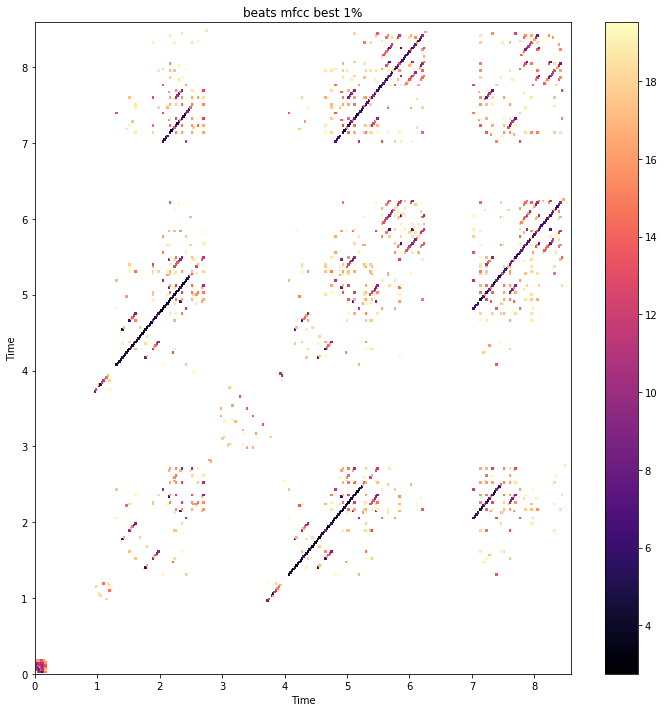

In [235]:
agg_mfcc_sm = librosa.segment.recurrence_matrix(agg_mfcc, mode='distance', metric='euclidean')
clean_agg_mfcc_sm, pairs = clean_similarity_matrix(agg_mfcc_sm, .1)
plot_similarity(clean_agg_mfcc_sm, 'beats mfcc best 1%')

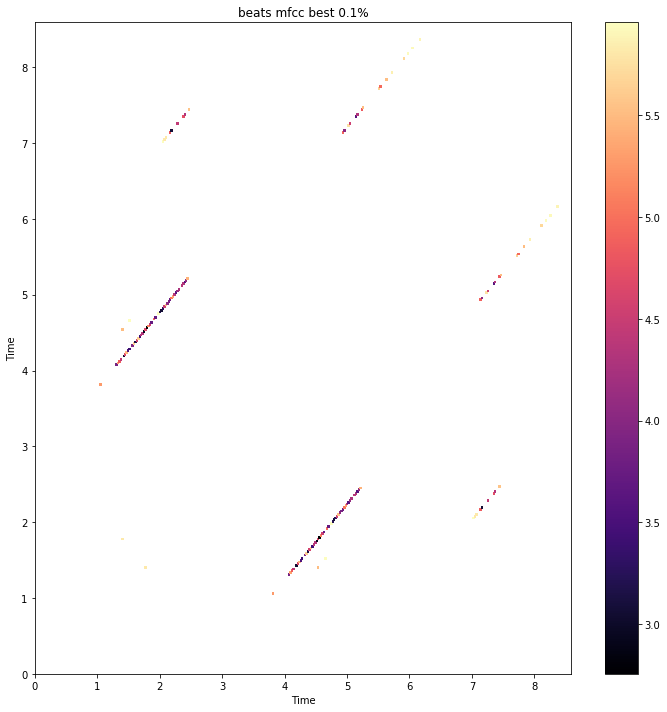

In [239]:
agg_mfcc_sm = librosa.segment.recurrence_matrix(agg_mfcc, mode='distance', metric='euclidean')
clean_agg_mfcc_sm, pairs = clean_similarity_matrix(agg_mfcc_sm, .01)
plot_similarity(clean_agg_mfcc_sm, 'beats mfcc best 0.1%')

## Creating a Looped Song
With the pair values obtained above, we can now attempt to match them and create a new song from this.

In [237]:
def beat_to_second(bpm, beat):
    return beat * 60 / bpm

def create_infinite_jukebox(audio, beat_pairs, chance, max_beats, total_song_beats, bpm):
    current_beat = 10 # play at least 10 beats before starting to jump
    total_beats = 0
    beat_skips = []
    start = 0

    while total_beats < total_song_beats and current_beat < max_beats:
        if (current_beat in beat_pairs and 
            random.random() < chance and 
            current_beat > start + 5):
            
            beat_skips.append((start, current_beat))
            current_beat = beat_pairs[current_beat]
            start = current_beat
        current_beat += 1
        total_beats += 1
    beat_skips.append((start, total_song_beats-1))
    new_audio = []
    print(beat_skips)
    for start_beat, end_beat in beat_skips:
        new_audio.extend(audio[beats[start_beat]:beats[end_beat]])
        
    time_jumps = [beat_to_second(bpm, x[1] - x[0]) for x in beat_skips]
    return new_audio, np.cumsum(time_jumps)

In [242]:
beat_pairs = {i: j for i, j, dist in pairs if i != 0 and j != 0}
print(beat_pairs)

new_audio, time_jumps = create_infinite_jukebox(audio, beat_pairs, 0.5, 1000, len(beats), bpm)
print(time_jumps)
Audio(new_audio, rate=sr)

{45: 164, 56: 175, 57: 176, 58: 177, 59: 178, 60: 195, 61: 180, 62: 181, 63: 182, 64: 183, 65: 200, 67: 186, 68: 187, 69: 188, 70: 189, 71: 190, 72: 191, 73: 192, 74: 193, 75: 194, 76: 195, 77: 196, 78: 197, 79: 198, 80: 199, 82: 201, 83: 202, 85: 204, 86: 205, 87: 206, 88: 302, 89: 303, 90: 304, 91: 210, 92: 211, 93: 307, 94: 308, 95: 214, 96: 215, 97: 216, 98: 312, 99: 218, 101: 220, 102: 316, 103: 317, 104: 223, 105: 224, 106: 320, 164: 45, 175: 56, 176: 57, 177: 58, 178: 59, 180: 61, 181: 62, 182: 63, 183: 64, 184: 65, 186: 67, 187: 68, 188: 69, 189: 70, 190: 71, 191: 72, 192: 73, 193: 74, 194: 75, 195: 76, 196: 77, 197: 78, 198: 79, 199: 80, 200: 65, 201: 82, 202: 83, 204: 85, 205: 86, 206: 87, 207: 88, 208: 89, 209: 90, 210: 91, 211: 92, 212: 307, 213: 308, 214: 95, 215: 96, 216: 311, 217: 312, 218: 99, 220: 101, 221: 316, 222: 317, 223: 104, 224: 105, 225: 320, 226: 321, 237: 332, 238: 333, 242: 337, 246: 341, 254: 349, 257: 352, 260: 355, 265: 360, 302: 88, 303: 89, 304: 90, 30